**Problem Statement** - The main objective of this study is to build an image classifier capable of determining severity of Alzheimer's based on the MRI Scan Image.

Dataset Source - *https://www.kaggle.com/datasets/tourist55/alzheimers-dataset-4-class-of-images*

**Data download and extraction:**

**Importing Libraries:**

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
#importing all the necessary libraries
import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow import keras
import pickle
import os
import re
import random
from keras.layers import Dense,Input,Conv2D,MaxPool2D,Activation,Dropout,Flatten,GlobalAveragePooling2D,Concatenate,BatchNormalization
from keras.models import Model
from keras.utils import plot_model
from keras.callbacks import ModelCheckpoint,ReduceLROnPlateau,EarlyStopping
import os
import random as rn
os.environ['PYTHONHASHSEED'] = '0'
keras.backend.clear_session()
np.random.seed(0)
rn.seed(0)
from keras.applications.densenet import DenseNet121,DenseNet169
#import seedir as sd
from keras.applications.inception_v3 import InceptionV3
from keras.applications import VGG19

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


**Dataset Details:**

In [3]:
#sd.seedir('/content/Alzheimers_Dataset/', style='emoji',beyond='content',depthlimit=2)

1.   The Alzheimers Dataset contains Train and Test Folders. Each Train and Test Folder has 4 sub folders by names ModerateDemented, MildDemented, VerMildDemented and NonDemented.
2.   In the train folder, ModerateDemented sub folder has 52 files, MildDemented subfolder has 717 files, VerMildDemented sub folder has 1792 files and NonDemented sub folder has 2560 files.
3.   In the test folder, ModerateDemented sub folder has 12 files, MildDemented subfolder has 179 files, VerMildDemented sub folder has 448 files and NonDemented sub folder has 640 files.


In [4]:
train_files  = []
train_labels = []
for root,dirs,files in os.walk('/kaggle/input/alzheimers-dataset-4-class-of-images/Alzheimer_s Dataset',topdown=False):
    for name in sorted(files):
        path = os.path.join(root,name)
        train_files.append(path)
        train_labels.append(path.split('/')[-2])

In [5]:
all_train_files = pd.DataFrame(list(zip(train_files,train_labels)),columns= ['image_path','image_label'])
all_train_files.head()

,image_path,image_label
0,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
1,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
2,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
3,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
4,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented


**Exploratory Data Analysis:**

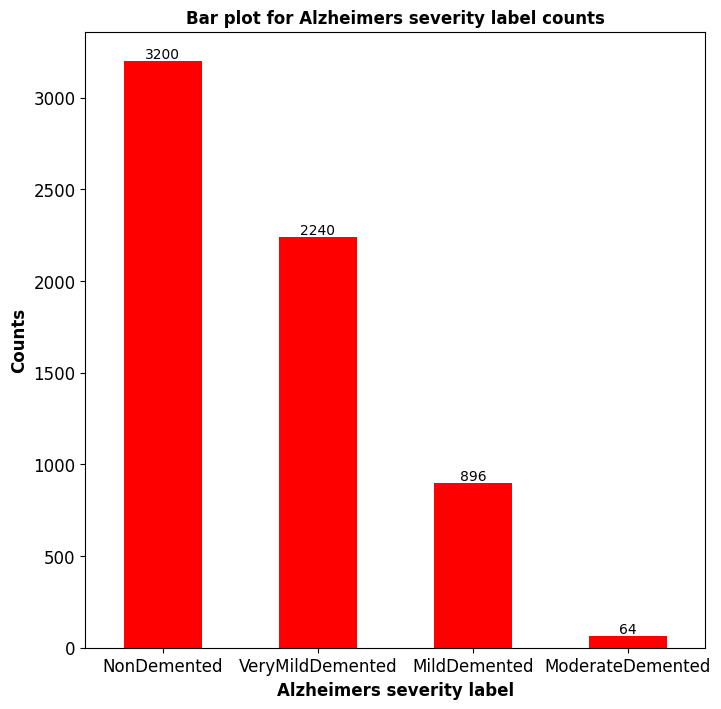

In [6]:
ax = all_train_files['image_label'].value_counts().plot(kind='bar',figsize=(8,8),color='red')
for c in ax.containers:
    # Optional: if the segment is small or 0, customize the labels
    labels = [v.get_height() if v.get_height() > 0 else '' for v in c]
    # remove the labels parameter if it's not needed for customized labels
    ax.bar_label(c, labels=labels, label_type='edge')
plt.ylabel('Counts',fontsize=12,fontweight='bold')  # sets the y label with the given fontsize and weight
plt.xlabel('Alzheimers severity label',fontsize=12,fontweight='bold')  # sets the x label with the given fontsize and weight  
plt.title('Bar plot for Alzheimers severity label counts',fontsize=12,fontweight='bold') # sets the title for the plot with the given fontsize and weight
plt.xticks(rotation = 0) # this makes the xlables display horizontally
plt.xticks(fontsize=12)  # sets the font size of x ticks
plt.yticks(fontsize=12)  # sets the font size of y ticks
plt.show()               # displays the plot 

**Observations:**<br>
1.Labels with Non Demented has the highest number of datapoints in the train dataset.<br>
2.Labels with Moderate Demented has the lowest number of datapoints in the train dataset.

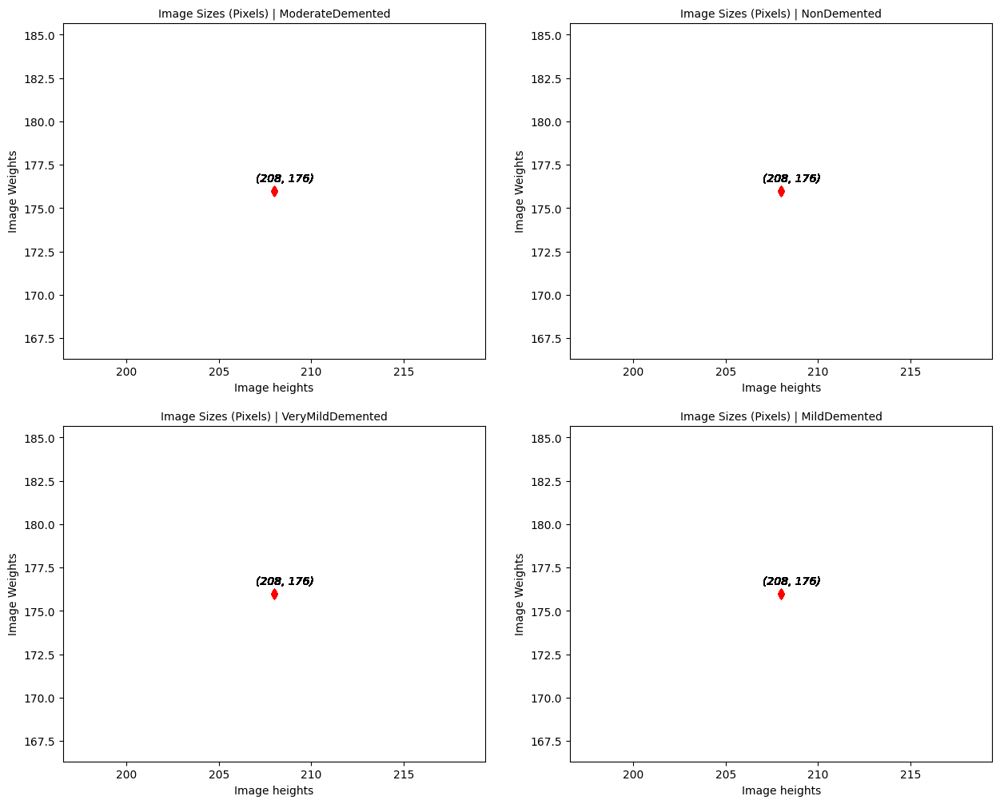

In [7]:
k = 1
plt.figure(figsize=(15,12))
for i in list(all_train_files['image_label'].unique()):
  group_list = list(all_train_files.groupby(['image_label']).get_group(i)['image_path'])
  image_heights = []
  image_widths  = [] 
  for j in group_list:
    image = tf.io.read_file(j)
    image = tf.image.decode_jpeg(image,channels=3)
    image_heights.append(image.shape[0])
    image_widths.append(image.shape[1])
  plt.subplot(2,2,k)
  plt.scatter(image_heights,image_widths,color='red',marker='d')
  for o, p in zip(image_heights, image_widths):
   plt.text(o-1, p+0.5, '({}, {})'.format(o, p),fontstyle='italic',fontsize=10)
  plt.xlabel('Image heights',fontsize=10)
  plt.ylabel('Image Weights',fontsize=10)
  plt.title('Image Sizes (Pixels) | '+i,fontsize=10)
  plt.xticks(fontsize=10)  
  plt.yticks(fontsize=10)
  k = k + 1   
plt.show()

**Observations:**<br>
It can been observed that the Image height and weight for all the images in each label are found to be same and they are 208 and 176 respectively.

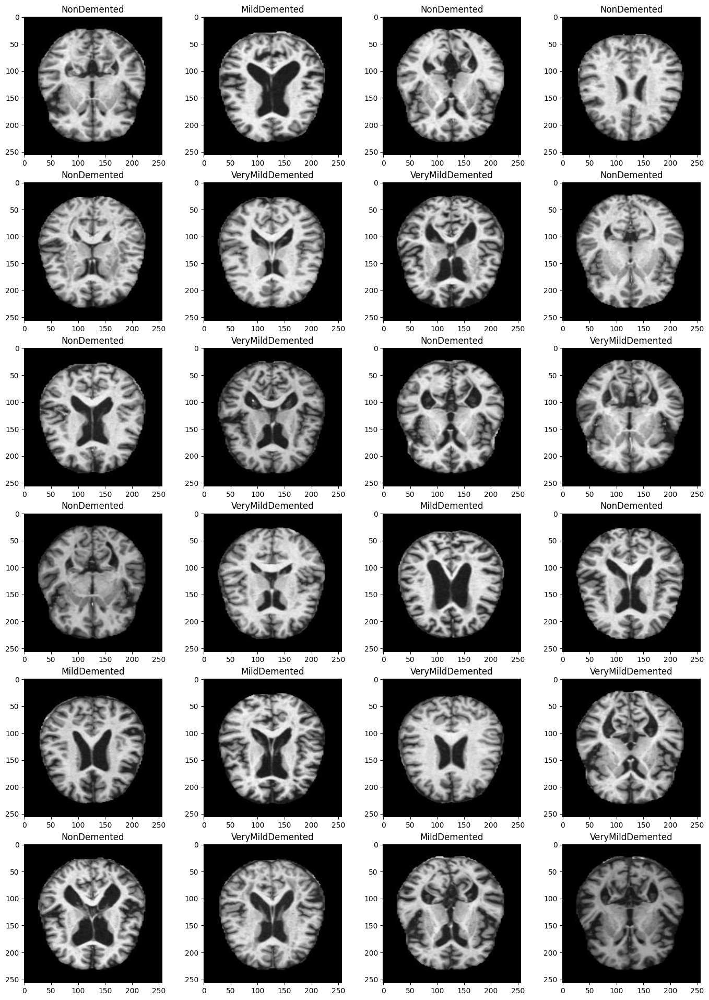

In [8]:
#Plotting few images with labels from the train dataset.
plt.figure(figsize=(17,24))
for i in range(24):
  plt.subplot(6,4,i+1)
  r1 = random.randint(0, len(all_train_files))
  image = tf.io.read_file(list(all_train_files['image_path'])[r1])
  image = tf.image.decode_jpeg(image,channels=3)
  image = tf.image.convert_image_dtype(image,tf.float32)
  image = tf.image.resize(image,[256,256])
  plt.imshow(image)
  plt.title(all_train_files['image_label'][r1])
plt.show()  

**Train Test Split**

In [9]:
from sklearn.model_selection import train_test_split
Train, validation = train_test_split(all_train_files,test_size=0.33, stratify = all_train_files['image_label'],random_state=42)

**Data Preparation using Keras Image Datagenerator**

In [10]:
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1./255,shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True)

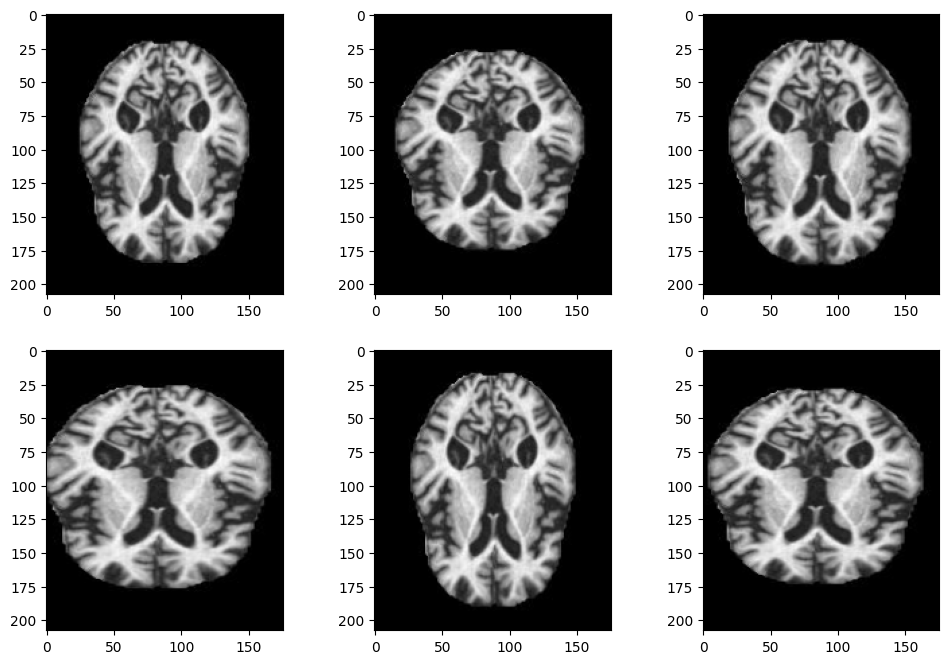

In [11]:
#visualizing augmented images for a single sample image.
sample_image = '/kaggle/input/alzheimers-dataset-4-class-of-images/Alzheimer_s Dataset/train/ModerateDemented/moderateDem12.jpg'
sample_image = tf.io.read_file(sample_image)
sample_image = tf.image.decode_jpeg(sample_image,channels=3)
image_flow   = train_datagen.flow(sample_image[np.newaxis,:,:,:],batch_size=1)
plt.figure(figsize=(12,8))
for i in range(6): # creating 6 augmentated images
  image_augmented = next(image_flow)[0].astype('float32')
  plt.subplot(2,3,i+1)
  plt.imshow(image_augmented)
plt.show()

In [12]:
batch_size = 16
Img_size   = 256
train_dataset = train_datagen.flow_from_dataframe(
    dataframe=Train,
    x_col="image_path",
    y_col="image_label",
    target_size=(Img_size, Img_size),
    batch_size=batch_size,
    class_mode="categorical",
    shuffle =True,
    seed=42)

Found 4288 validated image filenames belonging to 4 classes.


**Visualizing few images from train datagenerator which is augmented.**

Batch 1  Images
******************************************************************************************


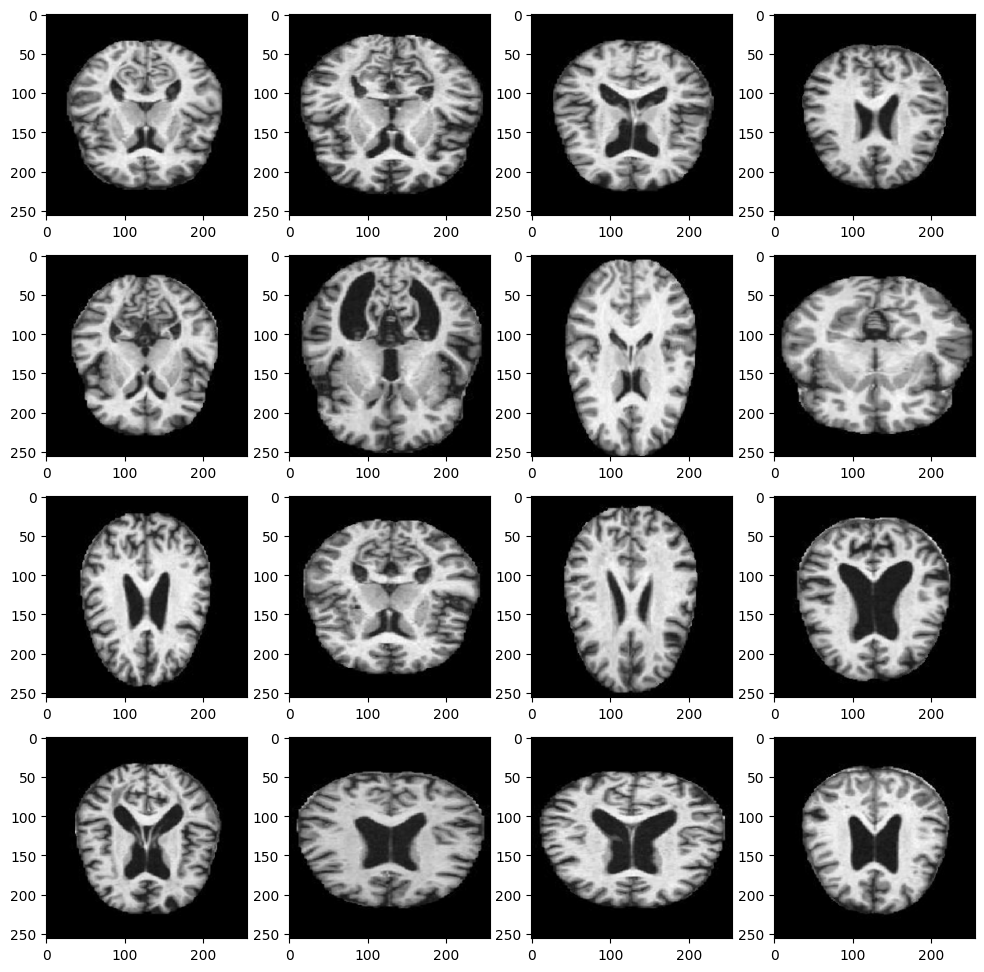

******************************************************************************************
Batch 2  Images
******************************************************************************************


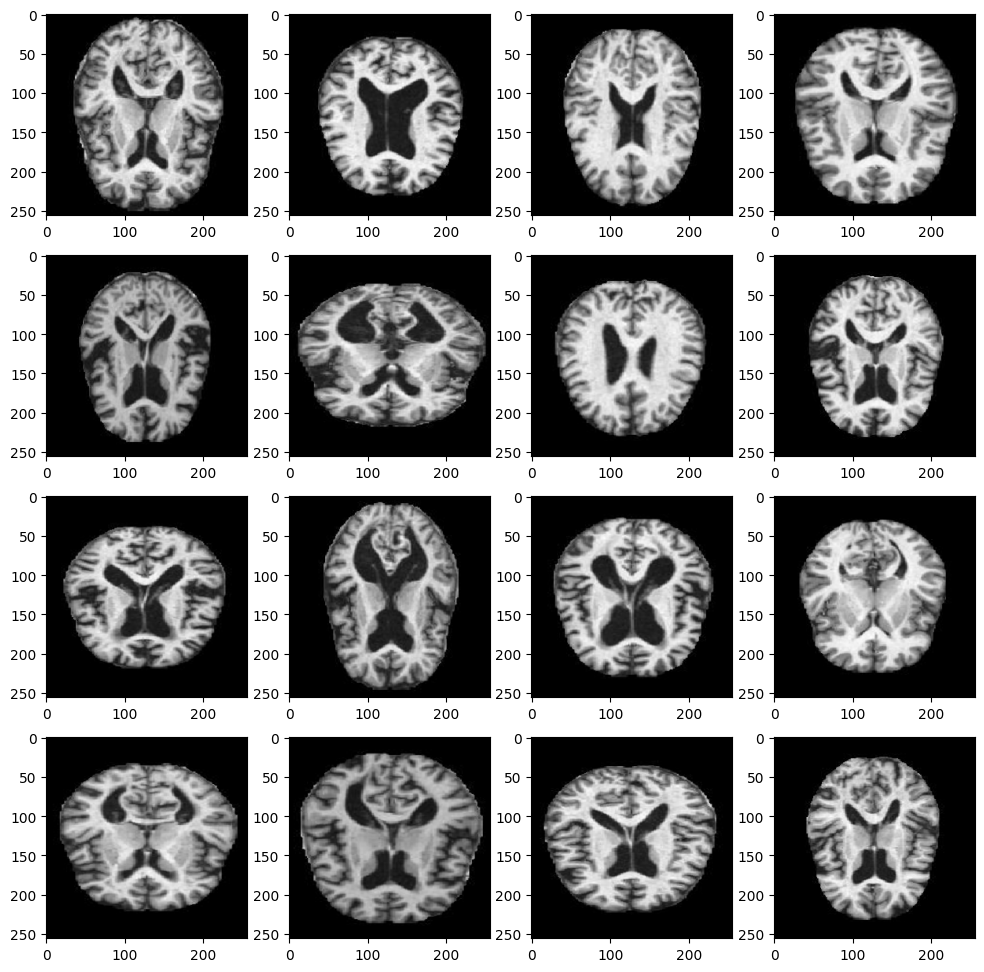

******************************************************************************************


In [13]:
#visualizing first 2 batch images from train data generator
for j in range(2):
  plt.figure(figsize=(12,12))
  print('Batch',format(j+1),' Images')
  print(90*'*')
  aug_image = next(train_dataset)[0].astype('float32')
  for i in range(batch_size):
    plt.subplot(4,4,i+1)
    plt.imshow(aug_image[i,:,:,:])
  plt.show() 
  print(90*'*') 

In [14]:
valid_datagen = ImageDataGenerator(rescale=1./255)

In [15]:
validation_dataset = valid_datagen.flow_from_dataframe(
    dataframe=validation,
    x_col="image_path",
    y_col="image_label",
    target_size=(Img_size, Img_size),
    batch_size=batch_size,
    class_mode="categorical",
    shuffle = False,
    seed=42)

Found 2112 validated image filenames belonging to 4 classes.


In [16]:
steps_per_epoch  = train_dataset.n//train_dataset.batch_size
validation_steps = validation_dataset.n//validation_dataset.batch_size


**Using pre-trained weights of DenseNet121**

In [17]:
from tensorflow.keras.applications.densenet import DenseNet121

input_layer = Input(shape=(Img_size, Img_size, 3))
base_DenseNet121 = DenseNet121(weights='imagenet', include_top=False, input_shape=(Img_size, Img_size, 3))
for layer in base_DenseNet121.layers:
    layer.trainable = False

x = base_DenseNet121(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(4, activation = 'softmax')(x)
DenseNet121_model = Model(inputs = input_layer, outputs = x)

29084464/29084464 [==============================] - 0s 0us/step


In [18]:
DenseNet121_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),
                          loss='categorical_crossentropy',metrics=['AUC'])

In [19]:
DenseNet121_model.summary(expand_nested=True,show_trainable=True)

Model: "model"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         Y          
                                                                            
 densenet121 (Functional)    (None, 8, 8, 1024)        7037504   Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_2 (InputLayer)      [(None, 256, 256, 3)]     0         N          |
|                                                                          |
| zero_padding2d (ZeroPadding  (None, 262, 262, 3)    0         N          |
| 2D)                                                                      |
|                                                                          |
| conv1/conv (Conv2D)       (None, 128, 128, 64)      9408      N          |
|                                                            

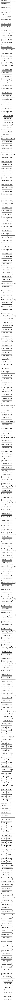

In [20]:
plot_model(DenseNet121_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [21]:
es        = EarlyStopping(monitor='val_auc', patience=5,verbose=1)
mc        = ModelCheckpoint('Densenet121.h5', monitor='val_auc', mode='max', save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1) 

In [22]:
DenseNet121_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 1.0924 - auc: 0.7971
Epoch 1: val_auc improved from -inf to 0.86939, saving model to Densenet121.h5
268/268 [==============================] - 86s 271ms/step - loss: 1.0924 - auc: 0.7971 - val_loss: 0.8502 - val_auc: 0.8694 - lr: 0.0010
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.7908 - auc: 0.8882
Epoch 2: val_auc improved from 0.86939 to 0.89531, saving model to Densenet121.h5
268/268 [==============================] - 72s 267ms/step - loss: 0.7908 - auc: 0.8882 - val_loss: 0.7674 - val_auc: 0.8953 - lr: 0.0010
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.6878 - auc: 0.9150
Epoch 3: val_auc did not improve from 0.89531
268/268 [==============================] - 70s 263ms/step - loss: 0.6878 - auc: 0.9150 - val_loss: 0.8329 - val_auc: 0.8944 - lr: 0.0010
Epoch 4/50
268/268 [==============================] - ETA: 0s - loss: 0.6513 - auc: 0.9233
Epoch 4: val_auc d

In [23]:
def plot_history(history,accuracy_title,loss_title):
    """
    This function summarizes history for AUC and loss
    by plotting loss and AUC for each epoch.
    """
    
    plt.plot(history.history['auc'])
    plt.plot(history.history['val_auc'])
    plt.title(accuracy_title)
    plt.ylabel('AUC')
    plt.xlabel('Epoch')
    plt.legend(['Training', 'Validation'], loc='upper right')
    plt.show()

    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(loss_title)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Training', 'Validation'], loc='upper right')
    plt.show()

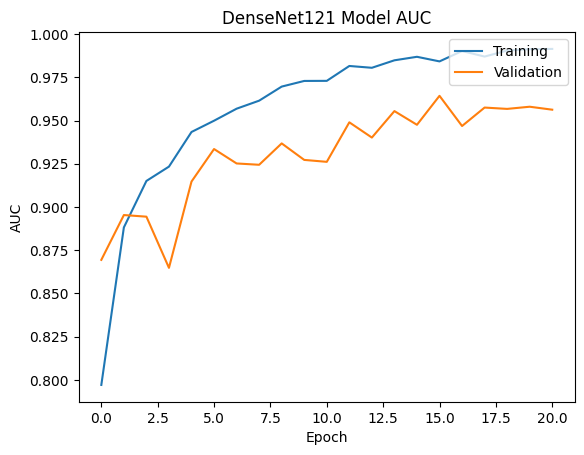

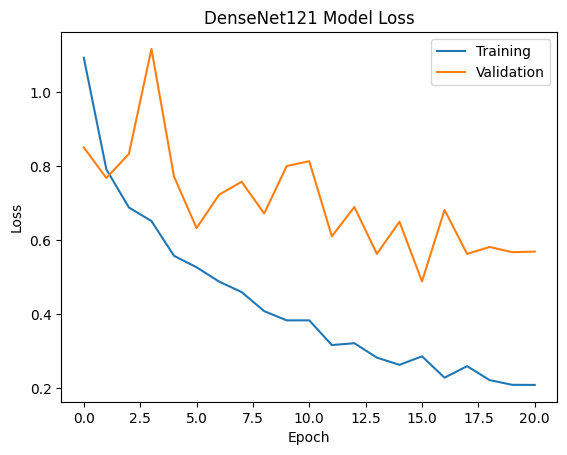

In [24]:
plot_history(DenseNet121_model.history,'DenseNet121 Model AUC','DenseNet121 Model Loss')

**Using pre-trained weights of DenseNet169**

In [25]:
input_layer = Input(shape = (Img_size,Img_size,3))
base_DenseNet169 = DenseNet169(weights = 'imagenet', include_top = False, input_shape = (Img_size,Img_size,3))
for layer in base_DenseNet169.layers:
    layer.trainable =  False

x = base_DenseNet169(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(4, activation = 'softmax')(x)
DenseNet169_model = Model(inputs = input_layer, outputs = x)

51877672/51877672 [==============================] - 0s 0us/step


In [26]:
DenseNet169_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),
                          loss='categorical_crossentropy',metrics=['AUC'])

In [27]:
DenseNet169_model.summary(expand_nested=True,show_trainable=True)

Model: "model_1"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_3 (InputLayer)        [(None, 256, 256, 3)]     0         Y          
                                                                            
 densenet169 (Functional)    (None, 8, 8, 1664)        12642880  Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_4 (InputLayer)      [(None, 256, 256, 3)]     0         N          |
|                                                                          |
| zero_padding2d_2 (ZeroPaddi  (None, 262, 262, 3)    0         N          |
| ng2D)                                                                    |
|                                                                          |
| conv1/conv (Conv2D)       (None, 128, 128, 64)      9408      N          |
|                                                          

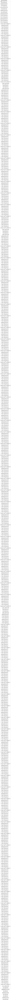

In [28]:
plot_model(DenseNet169_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [29]:
es        = EarlyStopping(monitor='val_auc',patience=5,verbose=1)
mc        = ModelCheckpoint('Densenet169.h5', monitor='val_auc',mode='max',save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1)

In [30]:
DenseNet169_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 1.0430 - auc: 0.8165
Epoch 1: val_auc improved from -inf to 0.85921, saving model to Densenet169.h5
268/268 [==============================] - 88s 289ms/step - loss: 1.0430 - auc: 0.8165 - val_loss: 0.8961 - val_auc: 0.8592 - lr: 0.0010
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.7676 - auc: 0.8952
Epoch 2: val_auc improved from 0.85921 to 0.89432, saving model to Densenet169.h5
268/268 [==============================] - 73s 273ms/step - loss: 0.7676 - auc: 0.8952 - val_loss: 0.7814 - val_auc: 0.8943 - lr: 0.0010
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.6857 - auc: 0.9158
Epoch 3: val_auc improved from 0.89432 to 0.91166, saving model to Densenet169.h5
268/268 [==============================] - 74s 275ms/step - loss: 0.6857 - auc: 0.9158 - val_loss: 0.7137 - val_auc: 0.9117 - lr: 0.0010
Epoch 4/50
268/268 [==============================] - ETA: 0s - loss: 0.6

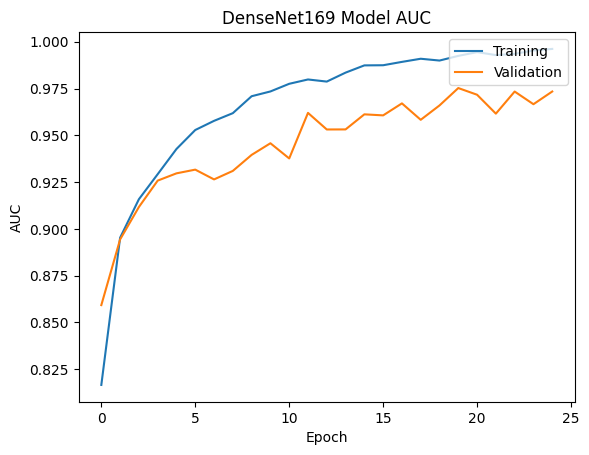

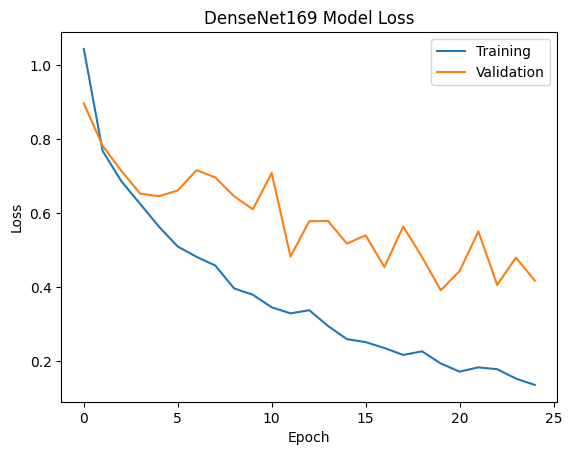

In [31]:
plot_history(DenseNet169_model.history,'DenseNet169 Model AUC','DenseNet169 Model Loss')

**Using Pre-trained weights of Inception V3**

In [32]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
input_layer = Input(shape = (Img_size,Img_size,3))
base_Inceptionv3 = InceptionV3(weights = 'imagenet', include_top = False, input_shape = (Img_size,Img_size,3))
for layer in base_Inceptionv3.layers:
    layer.trainable =  False

x = base_Inceptionv3(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(4, activation = 'softmax')(x)
Inceptionv3_model = Model(inputs = input_layer, outputs = x)

87910968/87910968 [==============================] - 0s 0us/step


In [33]:
Inceptionv3_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),
                          loss='categorical_crossentropy',metrics=['AUC'])

In [34]:
Inceptionv3_model.summary(expand_nested=True,show_trainable=True)

Model: "model_2"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_5 (InputLayer)        [(None, 256, 256, 3)]     0         Y          
                                                                            
 inception_v3 (Functional)   (None, 6, 6, 2048)        21802784  Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_6 (InputLayer)      [(None, 256, 256, 3)]     0         N          |
|                                                                          |
| conv2d (Conv2D)           (None, 127, 127, 32)      864       N          |
|                                                                          |
| batch_normalization_4 (Batc  (None, 127, 127, 32)   96        N          |
| hNormalization)                                                          |
|                                                          

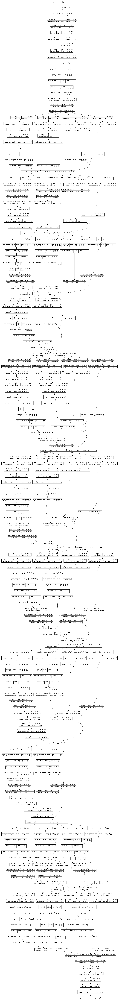

In [35]:
plot_model(Inceptionv3_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [36]:
es        = EarlyStopping(monitor='val_auc',patience=5,verbose=1)
mc        = ModelCheckpoint('Inceptionv3.h5', monitor='val_auc', mode='max', save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1)

In [37]:
Inceptionv3_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 1.1032 - auc: 0.7865
Epoch 1: val_auc improved from -inf to 0.85695, saving model to Inceptionv3.h5
268/268 [==============================] - 80s 274ms/step - loss: 1.1032 - auc: 0.7865 - val_loss: 0.8830 - val_auc: 0.8569 - lr: 0.0010
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.8864 - auc: 0.8548
Epoch 2: val_auc improved from 0.85695 to 0.87274, saving model to Inceptionv3.h5
268/268 [==============================] - 72s 267ms/step - loss: 0.8864 - auc: 0.8548 - val_loss: 0.8224 - val_auc: 0.8727 - lr: 0.0010
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.8365 - auc: 0.8695
Epoch 3: val_auc improved from 0.87274 to 0.88279, saving model to Inceptionv3.h5
268/268 [==============================] - 69s 259ms/step - loss: 0.8365 - auc: 0.8695 - val_loss: 0.7960 - val_auc: 0.8828 - lr: 0.0010
Epoch 4/50
268/268 [==============================] - ETA: 0s - loss: 0.8

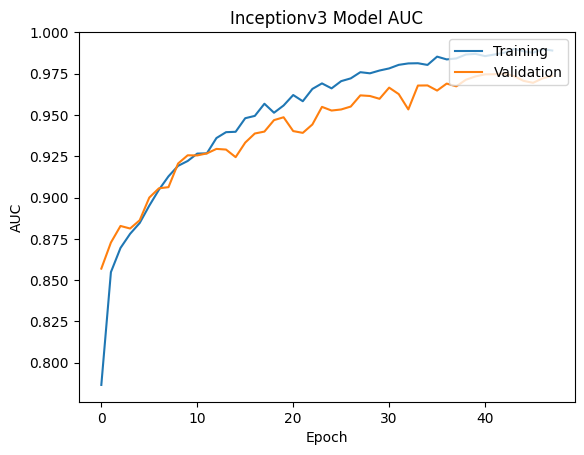

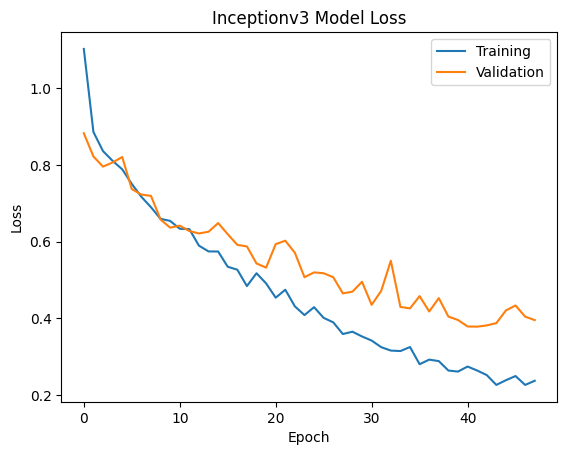

In [38]:
plot_history(Inceptionv3_model.history,'Inceptionv3 Model AUC','Inceptionv3 Model Loss')

**Using pre-trained weights of VGG19**

In [39]:
input_layer = Input(shape = (Img_size,Img_size,3))
base_vgg19 = VGG19(weights = 'imagenet', include_top = False, input_shape = (Img_size,Img_size,3))
for layer in base_vgg19.layers:
    layer.trainable =  False

x = base_vgg19(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(4, activation = 'softmax')(x)
Vgg19_model = Model(inputs = input_layer, outputs = x)

80134624/80134624 [==============================] - 0s 0us/step


In [40]:
Vgg19_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),\
                          loss='categorical_crossentropy',metrics=['AUC'])

In [41]:
Vgg19_model.summary(expand_nested=True,show_trainable=True)

Model: "model_3"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_7 (InputLayer)        [(None, 256, 256, 3)]     0         Y          
                                                                            
 vgg19 (Functional)          (None, 8, 8, 512)         20024384  Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_8 (InputLayer)      [(None, 256, 256, 3)]     0         N          |
|                                                                          |
| block1_conv1 (Conv2D)     (None, 256, 256, 64)      1792      N          |
|                                                                          |
| block1_conv2 (Conv2D)     (None, 256, 256, 64)      36928     N          |
|                                                                          |
| block1_pool (MaxPooling2D)  (None, 128, 128, 64)    0    

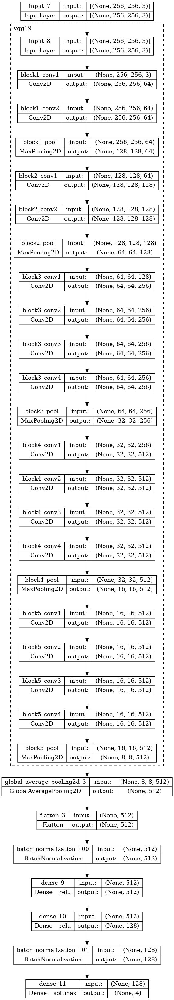

In [42]:
plot_model(Vgg19_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [43]:
es        = EarlyStopping(monitor='val_auc',patience=5,verbose=1)
mc        = ModelCheckpoint('Vgg19.h5', monitor='val_auc', mode='max', save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1)

In [45]:
Vgg19_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 0.3862 - auc: 0.9726
Epoch 1: val_auc did not improve from 0.96539
268/268 [==============================] - 72s 267ms/step - loss: 0.3862 - auc: 0.9726 - val_loss: 0.4823 - val_auc: 0.9596 - lr: 9.0000e-04
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.3695 - auc: 0.9744
Epoch 2: val_auc did not improve from 0.96539
268/268 [==============================] - 71s 263ms/step - loss: 0.3695 - auc: 0.9744 - val_loss: 0.4515 - val_auc: 0.9635 - lr: 9.0000e-04
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.3532 - auc: 0.9767
Epoch 3: val_auc improved from 0.96539 to 0.97125, saving model to Vgg19.h5
268/268 [==============================] - 71s 264ms/step - loss: 0.3532 - auc: 0.9767 - val_loss: 0.3988 - val_auc: 0.9713 - lr: 9.0000e-04
Epoch 4/50
268/268 [==============================] - ETA: 0s - loss: 0.3339 - auc: 0.9793
Epoch 4: val_auc improved from 0.97125 to 0.9

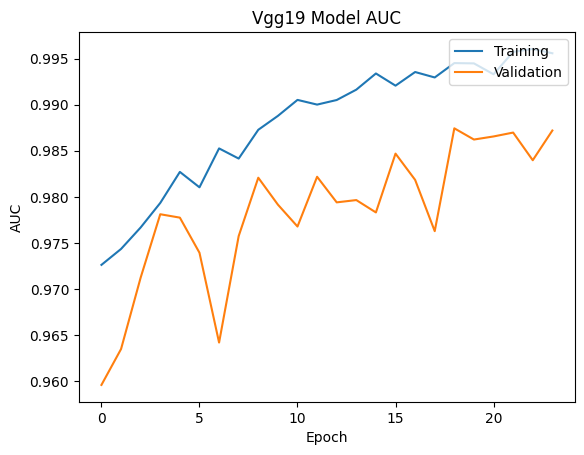

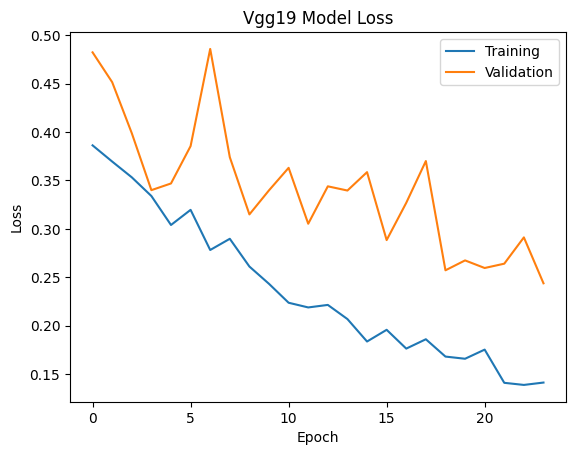

In [46]:
plot_history(Vgg19_model.history,'Vgg19 Model AUC','Vgg19 Model Loss')

**Using Pre-trained weights of DenseNet201**

In [47]:
from keras.applications import DenseNet201

In [48]:
input_layer = Input(shape = (Img_size,Img_size,3))
base_denseNet201   = DenseNet201(include_top = False,weights = 'imagenet', input_shape = (Img_size,Img_size,3))

for layer in base_denseNet201.layers:
    layer.trainable =  False

x = base_denseNet201(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(4, activation = 'softmax')(x)
denseNet201_model = Model(inputs = input_layer, outputs = x)

74836368/74836368 [==============================] - 0s 0us/step


In [49]:
denseNet201_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),\
                          loss='categorical_crossentropy',metrics=['AUC'])

In [50]:
denseNet201_model.summary(expand_nested=True,show_trainable=True)

Model: "model_4"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_9 (InputLayer)        [(None, 256, 256, 3)]     0         Y          
                                                                            
 densenet201 (Functional)    (None, 8, 8, 1920)        18321984  Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_10 (InputLayer)     [(None, 256, 256, 3)]     0         N          |
|                                                                          |
| zero_padding2d_4 (ZeroPaddi  (None, 262, 262, 3)    0         N          |
| ng2D)                                                                    |
|                                                                          |
| conv1/conv (Conv2D)       (None, 128, 128, 64)      9408      N          |
|                                                          

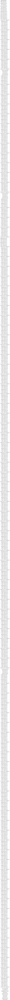

In [51]:
plot_model(denseNet201_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [52]:
es        = EarlyStopping(monitor='val_auc',patience=5,verbose=1)
mc        = ModelCheckpoint('denseNet201.h5', monitor='val_auc', mode='max', save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1)

In [53]:
denseNet201_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 1.0761 - auc: 0.8043
Epoch 1: val_auc improved from -inf to 0.87114, saving model to denseNet201.h5
268/268 [==============================] - 94s 300ms/step - loss: 1.0761 - auc: 0.8043 - val_loss: 0.8411 - val_auc: 0.8711 - lr: 0.0010
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.7595 - auc: 0.8966
Epoch 2: val_auc improved from 0.87114 to 0.89302, saving model to denseNet201.h5
268/268 [==============================] - 79s 294ms/step - loss: 0.7595 - auc: 0.8966 - val_loss: 0.7744 - val_auc: 0.8930 - lr: 0.0010
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.6665 - auc: 0.9196
Epoch 3: val_auc improved from 0.89302 to 0.90902, saving model to denseNet201.h5
268/268 [==============================] - 77s 287ms/step - loss: 0.6665 - auc: 0.9196 - val_loss: 0.7421 - val_auc: 0.9090 - lr: 0.0010
Epoch 4/50
268/268 [==============================] - ETA: 0s - loss: 0.5

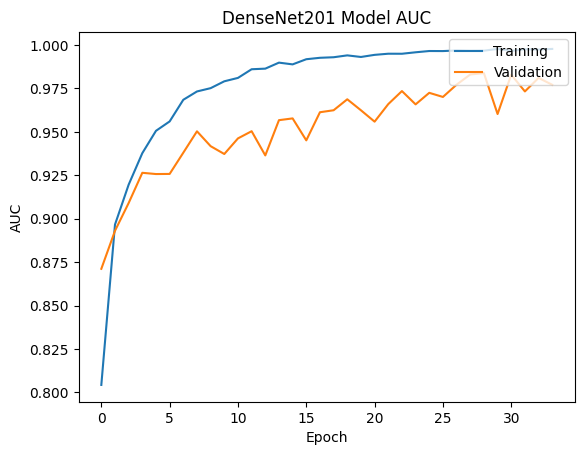

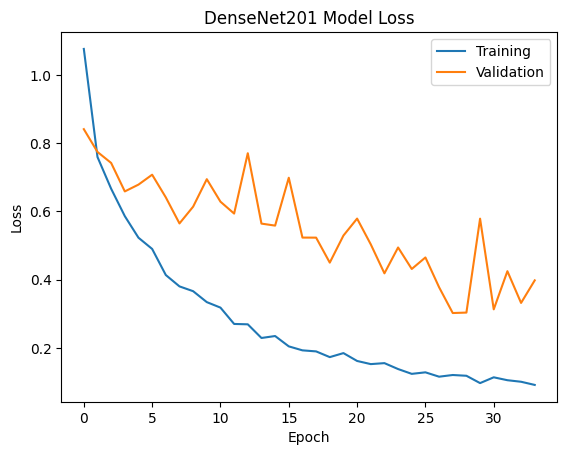

In [54]:
plot_history(denseNet201_model.history,'DenseNet201 Model AUC','DenseNet201 Model Loss')

**Stacking Pre-trained weights of Dense201 and VGG19**

In [55]:
input_layer = Input(shape = (Img_size,Img_size,3))
base_denseNet201   = DenseNet201(weights = 'imagenet', include_top = False, input_shape = (Img_size,Img_size,3))
base_vgg19         = VGG19(weights = 'imagenet', include_top = False, input_shape = (Img_size,Img_size,3))

for layer in base_denseNet201.layers:
    layer.trainable =  False
for layer in base_vgg19.layers:
    layer.trainable =  False

x = base_denseNet201(input_layer)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)

y = base_vgg19(input_layer)
y = GlobalAveragePooling2D()(y)
y = Flatten()(y)

z = Concatenate()([x,y])
z = BatchNormalization()(z)
z = Dense(512, activation='relu')(z)
z = Dense(128, activation='relu')(z)
z = BatchNormalization()(z)
z = Dense(4, activation = 'softmax')(z)
denseNet201_vgg19_model = Model(inputs = input_layer, outputs = z)

In [56]:
denseNet201_vgg19_model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001),\
                          loss='categorical_crossentropy',metrics=['AUC'])

In [57]:
denseNet201_vgg19_model.summary(expand_nested=True,show_trainable=True)

Model: "model_5"
_____________________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     Trainable  
 input_11 (InputLayer)          [(None, 256, 256, 3  0           []                               Y          
                                )]                                                                           
                                                                                                             
 densenet201 (Functional)       (None, 8, 8, 1920)   18321984    ['input_11[0][0]']               Y          
|¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯¯|
| input_12 (InputLayer)        [(None, 256, 256, 3  0           []                               N          |
|                              )]                                                                      

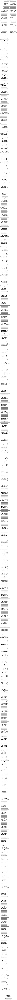

In [58]:
plot_model(denseNet201_vgg19_model, show_shapes=True,expand_nested=True,show_layer_activations=True)

In [59]:
es        = EarlyStopping(monitor='val_auc',patience=5,verbose=1)
mc        = ModelCheckpoint('denseNet201_vgg19.h5', monitor='val_auc', mode='max', save_best_only=True,verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_auc', factor=0.9, patience=2,mode='max',verbose=1)

In [60]:
denseNet201_vgg19_model.fit(train_dataset,steps_per_epoch=steps_per_epoch,
                      validation_data  = validation_dataset,epochs=50,
                      validation_steps = validation_steps,
                      callbacks        = [mc,reduce_lr,es])

Epoch 1/50
268/268 [==============================] - ETA: 0s - loss: 1.0529 - auc: 0.8120
Epoch 1: val_auc improved from -inf to 0.86945, saving model to denseNet201_vgg19.h5
268/268 [==============================] - 103s 337ms/step - loss: 1.0529 - auc: 0.8120 - val_loss: 0.8555 - val_auc: 0.8694 - lr: 0.0010
Epoch 2/50
268/268 [==============================] - ETA: 0s - loss: 0.7379 - auc: 0.9032
Epoch 2: val_auc improved from 0.86945 to 0.89682, saving model to denseNet201_vgg19.h5
268/268 [==============================] - 87s 324ms/step - loss: 0.7379 - auc: 0.9032 - val_loss: 0.7598 - val_auc: 0.8968 - lr: 0.0010
Epoch 3/50
268/268 [==============================] - ETA: 0s - loss: 0.6353 - auc: 0.9276
Epoch 3: val_auc improved from 0.89682 to 0.91376, saving model to denseNet201_vgg19.h5
268/268 [==============================] - 87s 326ms/step - loss: 0.6353 - auc: 0.9276 - val_loss: 0.7427 - val_auc: 0.9138 - lr: 0.0010
Epoch 4/50
268/268 [==============================] - 

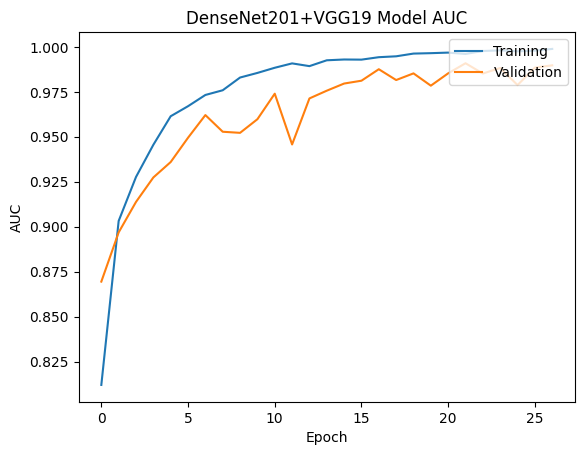

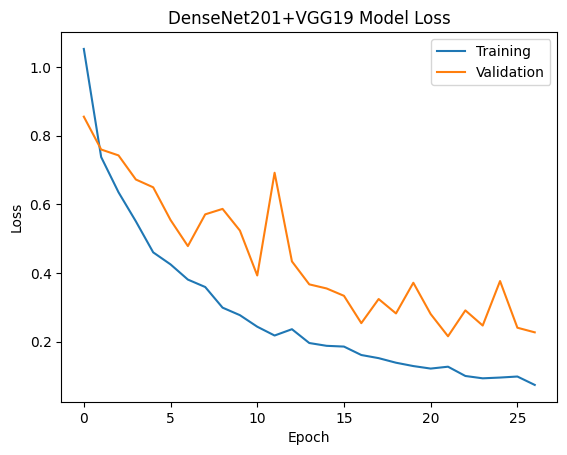

In [61]:
plot_history(denseNet201_vgg19_model.history,'DenseNet201+VGG19 Model AUC','DenseNet201+VGG19 Model Loss')

**Predictions on test data:**

In [62]:
test_files  = []
test_labels = []
for root,dirs,files in os.walk('/kaggle/input/alzheimers-dataset-4-class-of-images/Alzheimer_s Dataset/test',topdown=False):
  for name in sorted(files):
    path = os.path.join(root,name)
    test_files.append(path)
    test_labels.append(path.split('/')[-2])

In [63]:
all_test_files = pd.DataFrame(list(zip(test_files,test_labels)),columns= ['image_path','image_label'])
all_test_files.head()

,image_path,image_label
0,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
1,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
2,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
3,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented
4,/kaggle/input/alzheimers-dataset-4-class-of-im...,ModerateDemented


In [64]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [65]:
test_dataset = test_datagen.flow_from_dataframe(
    dataframe=all_test_files,
    x_col="image_path",
    y_col="image_label",
    target_size=(Img_size, Img_size),
    batch_size=batch_size,
    class_mode="categorical",
    shuffle = False,
    seed=42)

Found 1279 validated image filenames belonging to 4 classes.


In [66]:
DenseNet121_model_trained        = keras.models.load_model('/kaggle/working/Densenet121.h5')
DenseNet169_model_trained        = keras.models.load_model('/kaggle/working/Densenet169.h5')
Inceptionv3_model_trained        = keras.models.load_model('/kaggle/working/Inceptionv3.h5')
Vgg19_model_trained              = keras.models.load_model('/kaggle/working/Vgg19.h5')
DenseNet201_model_trained        = keras.models.load_model('/kaggle/working/denseNet201.h5')
DenseNet201_vgg19_model_trained  = keras.models.load_model('/kaggle/working/denseNet201_vgg19.h5')

In [67]:
DenseNet121_model_trained.evaluate(test_dataset)

80/80 [==============================] - 6s 52ms/step - loss: 0.4915 - auc: 0.9657


[0.49154770374298096, 0.9656813144683838]

In [68]:
DenseNet169_model_trained.evaluate(test_dataset)

80/80 [==============================] - 8s 61ms/step - loss: 0.2284 - auc: 0.9894


[0.22842834889888763, 0.9893953204154968]

In [69]:
Inceptionv3_model_trained.evaluate(test_dataset)

80/80 [==============================] - 5s 47ms/step - loss: 0.1948 - auc: 0.9919


[0.1948387324810028, 0.9919251799583435]

In [70]:
Vgg19_model_trained.evaluate(test_dataset)

80/80 [==============================] - 6s 76ms/step - loss: 0.1119 - auc: 0.9963


[0.11193857342004776, 0.9962788820266724]

In [71]:
DenseNet201_model_trained.evaluate(test_dataset)

80/80 [==============================] - 9s 74ms/step - loss: 0.1792 - auc: 0.9934


[0.1791711151599884, 0.9933934211730957]

In [72]:
DenseNet201_vgg19_model_trained.evaluate(test_dataset)

80/80 [==============================] - 14s 114ms/step - loss: 0.1070 - auc: 0.9973


[0.10703764110803604, 0.9972572326660156]

**Results:**

In [73]:
from prettytable import PrettyTable
x = PrettyTable()
x.field_names = ["Model","Train Loss", "CV Loss","Test Loss", "Train AUC", "CV AUC","Test AUC"]
x.add_row(['DenseNet121',0.2156,0.4098,1.6383,0.9909,0.9726,0.8444])
x.add_row(['DenseNet169',0.2588,0.3715,1.0510,0.9873,0.9756,0.8823])
x.add_row(['InceptionV3',0.2148,0.3620,1.4150, 0.9908,0.9765,0.8547])
x.add_row(['VGG19',0.2010,0.1940,1.0943,0.9915,0.9916,0.8939])
x.add_row(['DenseNet201',0.1510,0.3166,1.5653,0.9951,0.9830,0.8586])
x.add_row(['DenseNet201+VGG19',0.0847,0.1375,1.2007,0.9983,0.9958,0.8980])

print(x)

+-------------------+------------+---------+-----------+-----------+--------+----------+
|       Model       | Train Loss | CV Loss | Test Loss | Train AUC | CV AUC | Test AUC |
+-------------------+------------+---------+-----------+-----------+--------+----------+
|    DenseNet121    |   0.2156   |  0.4098 |   1.6383  |   0.9909  | 0.9726 |  0.8444  |
|    DenseNet169    |   0.2588   |  0.3715 |   1.051   |   0.9873  | 0.9756 |  0.8823  |
|    InceptionV3    |   0.2148   |  0.362  |   1.415   |   0.9908  | 0.9765 |  0.8547  |
|       VGG19       |   0.201    |  0.194  |   1.0943  |   0.9915  | 0.9916 |  0.8939  |
|    DenseNet201    |   0.151    |  0.3166 |   1.5653  |   0.9951  | 0.983  |  0.8586  |
| DenseNet201+VGG19 |   0.0847   |  0.1375 |   1.2007  |   0.9983  | 0.9958 |  0.898   |
+-------------------+------------+---------+-----------+-----------+--------+----------+


From the above table of results, it can be observed that the model built using pre-trained weights of Stacked model (DenseNet201+VGG19) has the highest Test AUC of 0.898(~0.9). Therefore, we can confirm that Stacked model (DenseNet201+VGG19) has performed better than all the other models which were considered for this study on Alzheimers dataset. These models are tested with Adam optimizer with 0.001 learning rate.

**Visualizing Actual and Predicted Labels on Random Sample Test data using the best model:**

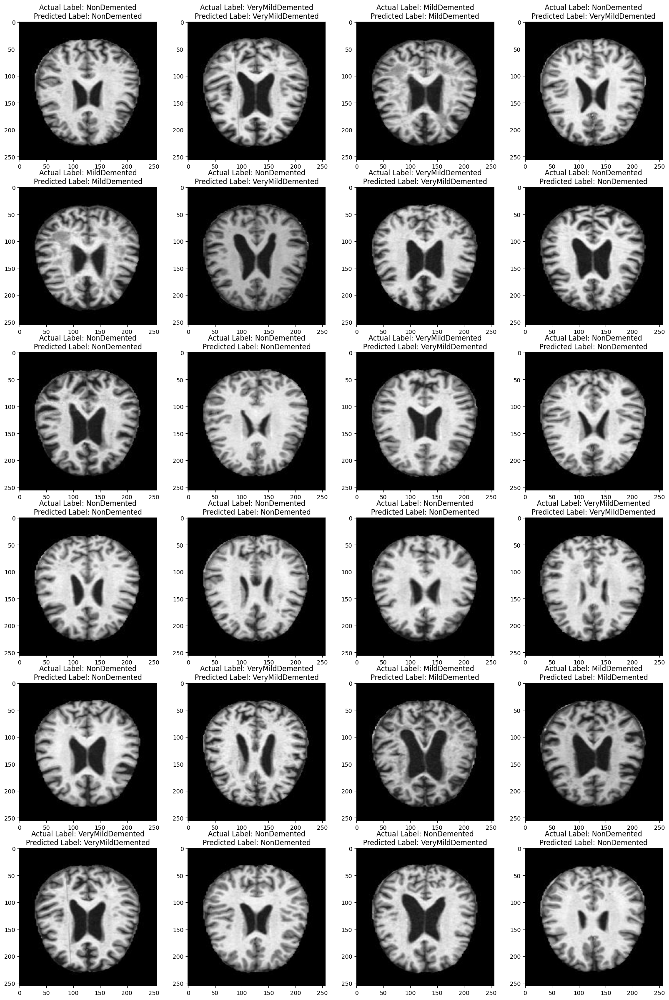

In [74]:
#using DenseNet201_vgg19_model_trained model for the predictions on random sample test data.
plt.figure(figsize=(20,30))
for i in range(24):
  plt.subplot(6,4,i+1)
  r = random.randint(0, len(all_test_files))
  image = tf.io.read_file(all_test_files['image_path'].to_list()[r])
  image = tf.image.decode_jpeg(image, channels=3)
  image = image/255
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, [256, 256])
  plt.imshow(image)
  actual_label = all_test_files['image_label'].to_list()[r]
  predicted_label = list(train_dataset.class_indices.keys())[np.argmax(DenseNet201_vgg19_model_trained.predict(image[np.newaxis,:,:,:],verbose=0))]
  plt.title('Actual Label: '+ actual_label + '\n' + 'Predicted Label: ' + predicted_label)
plt.show()

**Classification Report for test data:**

In [75]:
#finding predictions on test data using DenseNet201_vgg19_model_trained trained model
test_predictions = np.argmax(DenseNet201_vgg19_model_trained.predict(test_dataset),axis=-1)

80/80 [==============================] - 12s 105ms/step


In [76]:
#true labels of test data 
true_classes = test_dataset.classes

In [77]:
#Unique names of the labels 
class_labels = list(test_dataset.class_indices.keys())  

In [78]:
from sklearn.metrics import classification_report
report = classification_report(true_classes, test_predictions, target_names=class_labels)
print(report) 

                  precision    recall  f1-score   support

    MildDemented       1.00      0.97      0.98       179
ModerateDemented       1.00      1.00      1.00        12
     NonDemented       0.94      1.00      0.97       640
VeryMildDemented       0.99      0.92      0.95       448

        accuracy                           0.96      1279
       macro avg       0.98      0.97      0.97      1279
    weighted avg       0.96      0.96      0.96      1279



**References:**


1.*https://earnestt1234.github.io/seedir/seedir/index.html*<br>